In [26]:
import networkx as nx
from networkx.algorithms import community
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

In [64]:
# helpful functions
def plot_degree_distribution(degrees, title="Degree Distribution"):
    plt.hist(degrees, bins=100, color='skyblue', edgecolor='black', alpha=0.7)
    plt.title(title)
    plt.xlabel("Degree")
    plt.ylabel("Number of nodes")
    plt.show()

def get_top_items(dictionary, node_names, top_k=5):
    top_items = sorted(dictionary.items(), key=lambda x: x[1], reverse=True)[:top_k]
    for n, val in top_items:
        print(f"    {node_names.get(n,n)}: {val:.6f}")

def centralization(centrality_dict):
    n = len(centrality_dict)
    max_c = max(centrality_dict.values())
    return sum(max_c - v for v in centrality_dict.values()) / (n-1)

def calculate_metrics(G, node_names=None):
    if node_names is None:
        node_names = {}
    
    print(f"Graph is directed: {G.is_directed()}")
    print(f"1) Number Of Nodes: {G.number_of_nodes()}, Number Of Edges: {G.number_of_edges()}")
    
    # --- Degree ---
    if G.is_directed():
        in_degrees = np.array([d for _, d in G.in_degree()])
        out_degrees = np.array([d for _, d in G.out_degree()])
        total_degrees = in_degrees + out_degrees
        print(f"2a) Average In-Degree: {in_degrees.mean():.5f}")
        print(f"2b) Average Out-Degree: {out_degrees.mean():.5f}")
        print(f"2c) Average Total Degree: {total_degrees.mean():.5f}")
        degrees_for_distribution = total_degrees
    else:
        degrees = np.array([d for _, d in G.degree()])
        print(f"2) Average Degree: {degrees.mean():.5f}")
        degrees_for_distribution = degrees

    # --- Density ---
    print(f"3) Density: {nx.density(G):.7f}")
    
    # --- Connected Components ---
    if G.is_directed():
        if nx.is_strongly_connected(G):
            Gc = G
            print("4) Graph is strongly connected.")
        else:
            GCC_nodes = max(nx.strongly_connected_components(G), key=len)
            Gc = G.subgraph(GCC_nodes).copy()
            print(f"4) Graph is not strongly connected. Using largest SCC with {Gc.number_of_nodes()} nodes.")
    else:
        if nx.is_connected(G):
            Gc = G
            print("4) Graph is connected.")
        else:
            GCC_nodes = max(nx.connected_components(G), key=len)
            Gc = G.subgraph(GCC_nodes).copy()
            print(f"4) Graph is not connected. Using largest connected component with {Gc.number_of_nodes()} nodes.")
    
    # --- Diameter ---
    diameter = nx.diameter(Gc)
    print(f"   Diameter of considered component: {diameter}")
    
    # --- Clustering & Transitivity ---
    print(f"5) Average Clustering Coefficient: {nx.average_clustering(G):.5f}")
    print(f"6) Transitivity: {nx.transitivity(G):.4f}")
    
    # --- Average Shortest Path ---
    avg_shortest_path = nx.average_shortest_path_length(Gc)
    print(f"7) Average Shortest Path Length for considered component: {avg_shortest_path:.6f}")
    
    # --- Degree Distribution Plot ---
    print("8) Degree Distribution Plot")
    if nx.is_directed(G):
         plot_degree_distribution(in_degrees, "in-degree")
         plot_degree_distribution(out_degrees, "out-degree")
    plot_degree_distribution(degrees_for_distribution, "total-degree")
    
    # --- Assortativity ---
    if G.is_directed():
        assort_in = nx.degree_assortativity_coefficient(G, x='in', y='in')
        assort_out = nx.degree_assortativity_coefficient(G, x='out', y='out')
        print(f"9) Assortativity (in-in): {assort_in:.6f}")
        print(f"   Assortativity (out-out): {assort_out:.6f}")
    else:
        assort = nx.degree_assortativity_coefficient(G)
        print(f"9) Assortativity (degree correlation): {assort:.6f}")
    
    # --- Centrality ---
    if G.is_directed():
        degree_cent = nx.in_degree_centrality(G)
    else:
        degree_cent = nx.degree_centrality(G)
    betweenness_cent = nx.betweenness_centrality(Gc)
    closeness_cent = nx.closeness_centrality(Gc)
    pagerank_cent = nx.pagerank(G, alpha=0.85)
    
    print("\n10a) Top 5 nodes by Degree Centrality:")
    get_top_items(degree_cent, node_names)
    print("\n10b) Top 5 nodes by Betweenness Centrality:")
    get_top_items(betweenness_cent, node_names)
    print("\n10c) Top 5 nodes by Closeness Centrality:")
    get_top_items(closeness_cent, node_names)
    print("\n10d) Top 5 nodes by PageRank:")
    get_top_items(pagerank_cent, node_names)
    
    print("\n11) Network Centralization:")
    print(f"   Degree Centralization: {centralization(degree_cent):.6f}")
    print(f"   Betweenness Centralization: {centralization(betweenness_cent):.6f}")
    print(f"   Closeness Centralization: {centralization(closeness_cent):.6f}")
    print(f"   PageRank Centralization: {centralization(pagerank_cent):.6f}")

# Q1

In [67]:
G = nx.Graph()
node_names = {}
for i in range(1, 14):
    node_names[i] = f"node_{i}"

edges = [
    (1, 2), (1, 4), (1, 5),
    (2, 3), (2, 4),
    (4, 5), (4, 7),
    (6, 7), (6, 8), (6, 9), 
    (7, 9), (7, 8), (7, 10), 
    (8, 9),
    (9, 10), 
    (10, 12), (10, 13),
    (11, 12),
    (11, 13),
    (12, 13)
]

G.add_edges_from(edges)

Graph is directed: False
1) Number Of Nodes: 13, Number Of Edges: 20
2) Average Degree: 3.07692
3) Density: 0.2564103
4) Graph is connected.
   Diameter of considered component: 6
5) Average Clustering Coefficient: 0.62051
6) Transitivity: 0.5625
7) Average Shortest Path Length for considered component: 2.602564
8) Degree Distribution Plot


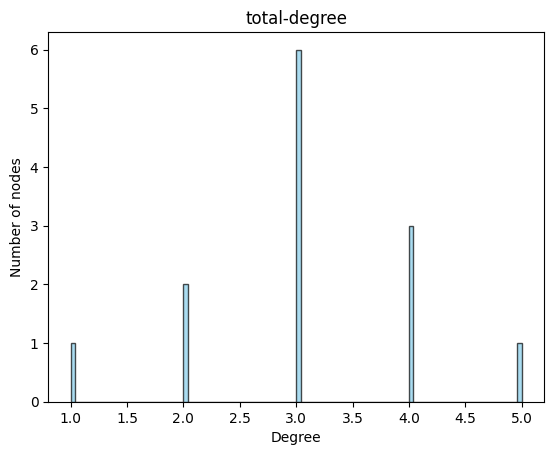

9) Assortativity (degree correlation): 0.166667

10a) Top 5 nodes by Degree Centrality:
    node_7: 0.416667
    node_4: 0.333333
    node_9: 0.333333
    node_10: 0.333333
    node_1: 0.250000

10b) Top 5 nodes by Betweenness Centrality:
    node_7: 0.590909
    node_4: 0.500000
    node_10: 0.409091
    node_2: 0.166667
    node_12: 0.075758

10c) Top 5 nodes by Closeness Centrality:
    node_7: 0.571429
    node_4: 0.500000
    node_10: 0.480000
    node_9: 0.461538
    node_6: 0.400000

10d) Top 5 nodes by PageRank:
    node_7: 0.110721
    node_4: 0.102465
    node_10: 0.092146
    node_9: 0.088882
    node_2: 0.087458

11) Network Centralization:
   Degree Centralization: 0.173611
   Betweenness Centralization: 0.482323
   Closeness Centralization: 0.185604
   PageRank Centralization: 0.036614


In [68]:
calculate_metrics(G, node_names)

In [29]:
communities = community.greedy_modularity_communities(G)
community_list = [list(c) for c in communities]

for i, c in enumerate(community_list):
    print(f"Community {i+1}: {sorted(c)}")

Community 1: [1, 2, 3, 4, 5]
Community 2: [6, 7, 8, 9]
Community 3: [10, 11, 12, 13]


In [30]:
modularity_total = community.modularity(G, communities)
print(f"Total Modularity of the network: {modularity_total:.4f}")

Total Modularity of the network: 0.5138


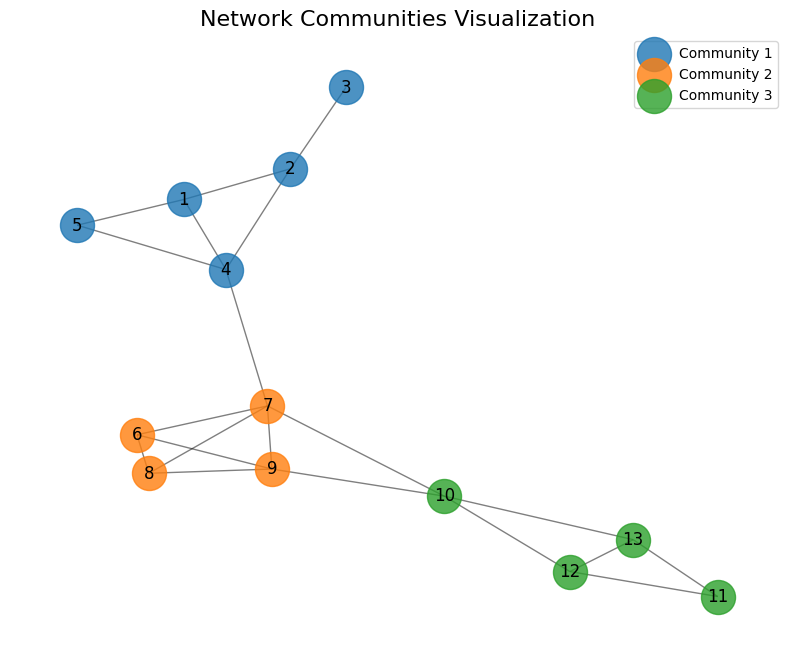

In [31]:
colors = list(mcolors.TABLEAU_COLORS.keys())

pos = nx.spring_layout(G, seed=42) 

plt.figure(figsize=(10, 8))

for i, com in enumerate(community_list):
    nx.draw_networkx_nodes(G, pos, nodelist=com, node_color=colors[i % len(colors)], 
                           node_size=600, alpha=0.8, label=f'Community {i+1}')

nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.5)
nx.draw_networkx_labels(G, pos, font_size=12)

plt.title("Network Communities Visualization", fontsize=16)
plt.axis('off')
plt.legend()
plt.show()

In [32]:
for i, com in enumerate(community_list):
    subG = G.subgraph(com)
    internal_edges = subG.number_of_edges()
    total_edges = G.number_of_edges()
    modularity_relative = internal_edges / total_edges
    print(f"Community {i+1}:")
    print(f"  Nodes: {sorted(com)}")
    print(f"  Internal edges: {internal_edges}")
    print(f"  Relative modularity (internal/total edges): {modularity_relative:.4f}")
    print()

Community 1:
  Nodes: [1, 2, 3, 4, 5]
  Internal edges: 6
  Relative modularity (internal/total edges): 0.3000

Community 2:
  Nodes: [6, 7, 8, 9]
  Internal edges: 6
  Relative modularity (internal/total edges): 0.3000

Community 3:
  Nodes: [10, 11, 12, 13]
  Internal edges: 5
  Relative modularity (internal/total edges): 0.2500



# Q2

In [39]:
# dataset path
EDGE_FILE = "data/hep-th.net"
NAMES_FILE = "data/hep-th_names.txt"

In [34]:
# read EDGE_FILE file
G = nx.read_edgelist(EDGE_FILE, nodetype=int)
node_names = {}
with open(NAMES_FILE, "r") as f:
    for line in f:
        node, name = line.strip().split(" ", 1)
        node_names[int(node)] = name
nx.set_node_attributes(G, node_names, "name")  

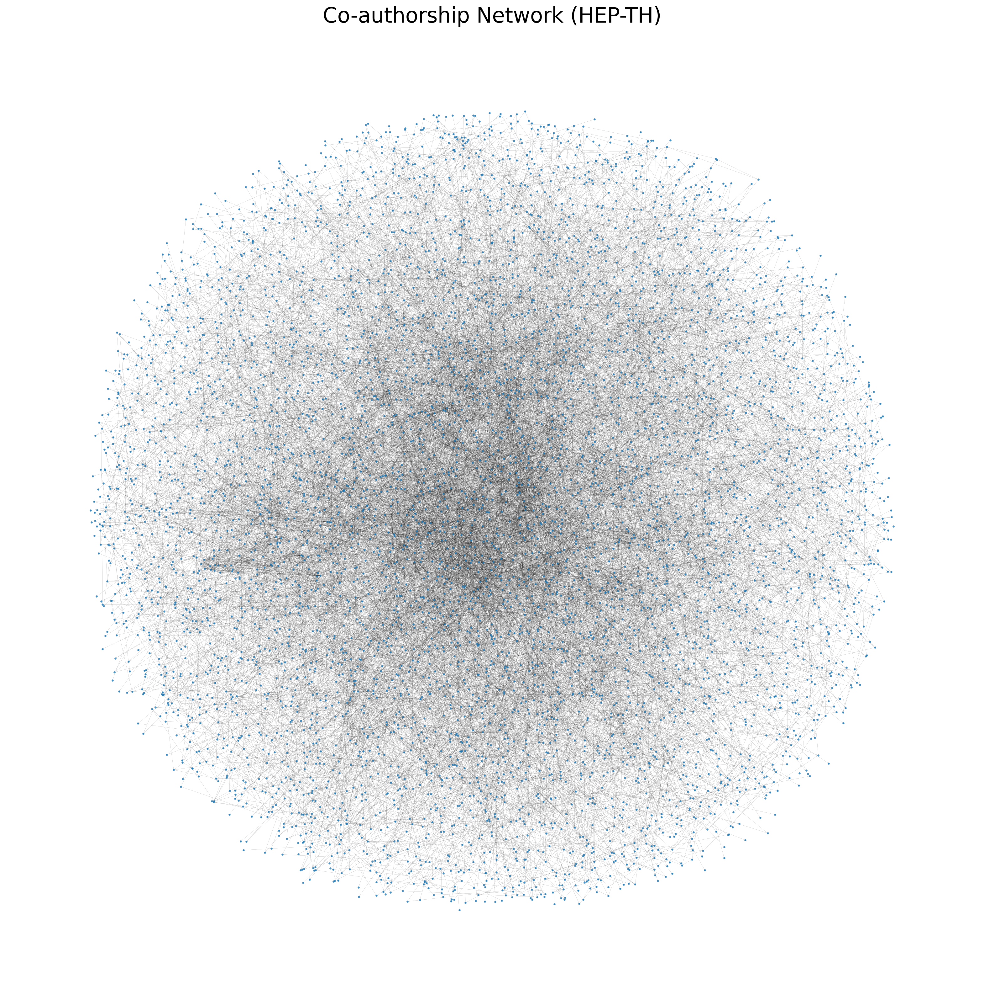

In [48]:
plt.figure(figsize=(20, 20), dpi=200)
pos = nx.spring_layout(G, k=0.15, iterations=50, seed=42)
nx.draw_networkx_nodes(G, pos, node_size=2, node_color='#1f78b4', alpha=0.7)
nx.draw_networkx_edges(G, pos, width=0.15, alpha=0.3, edge_color='black')
plt.title("Co-authorship Network (HEP-TH)", fontsize=24)
plt.axis("off")
plt.show()

In [52]:
communities = list(community.greedy_modularity_communities(G))
partition = {node: i for i, comm in enumerate(communities) for node in comm}
mod_value = community.modularity(G, communities)
print(f"Modularity: {mod_value:.4f} \nNumber of communities: {len(communities)}")

Modularity: 0.7769 
Number of communities: 83


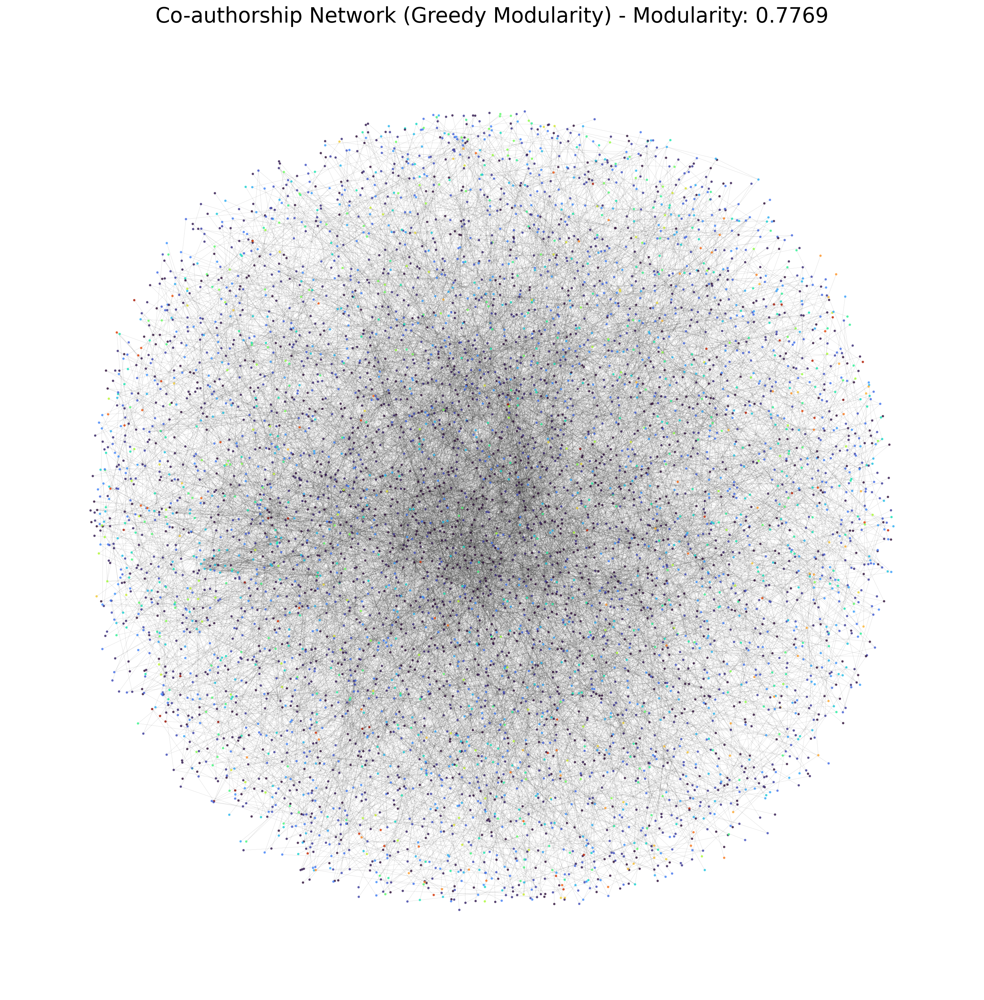

In [54]:
plt.figure(figsize=(20, 20), dpi=200)
pos = nx.spring_layout(G, k=0.15, iterations=50, seed=42)
colors = [partition[node] for node in G.nodes()]

nx.draw_networkx_nodes(G, pos, node_size=3, node_color=colors, cmap=plt.cm.turbo, alpha=0.7)
nx.draw_networkx_edges(G, pos, width=0.15, alpha=0.3, edge_color='black')
plt.title(f"Co-authorship Network (Greedy Modularity) - Modularity: {mod_value:.4f}", fontsize=24)
plt.axis("off")
plt.show()

In [55]:
pos = {}
center_points = nx.circular_layout(range(len(communities)), scale=10)
for i, comm in enumerate(communities):
    subgraph = G.subgraph(comm)
    local_pos = nx.spring_layout(subgraph, center=center_points[i], k=0.3)
    pos.update(local_pos)

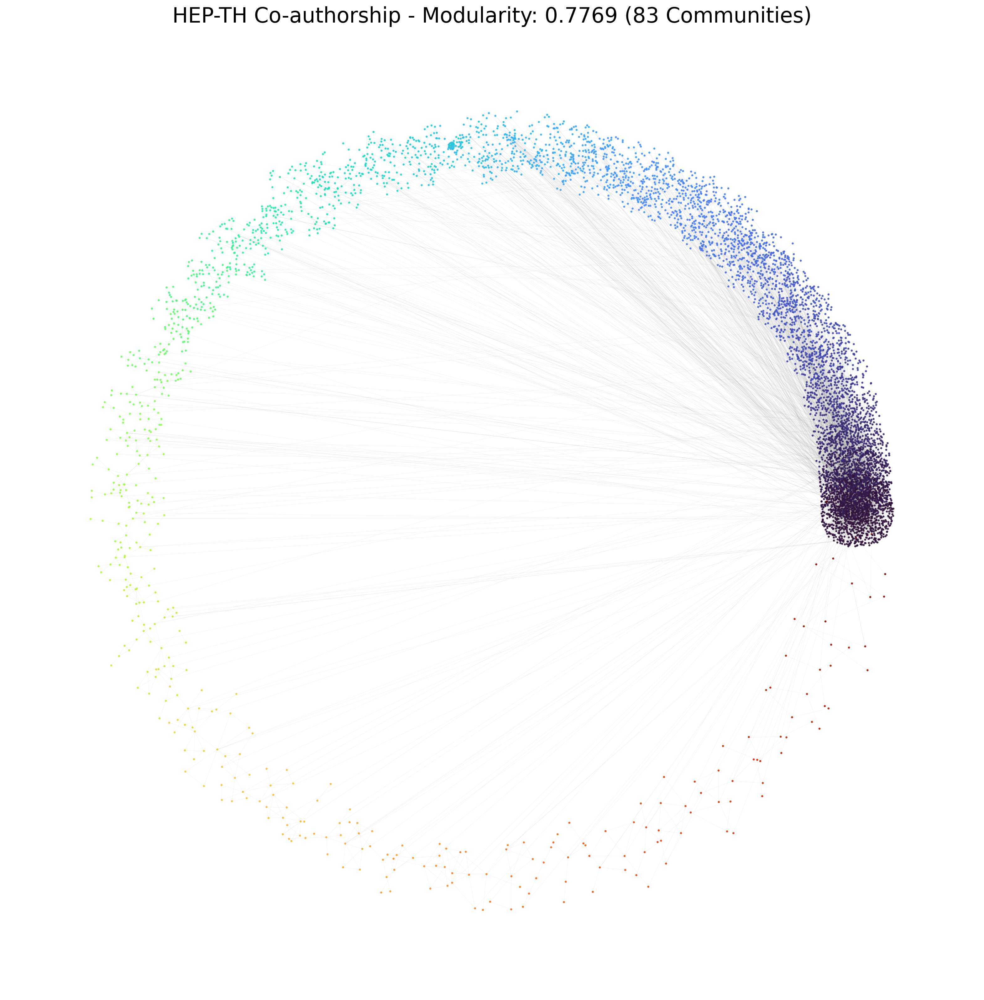

In [56]:
plt.figure(figsize=(20, 20), dpi=200)
colors = [partition[node] for node in G.nodes()]

nx.draw_networkx_nodes(G, pos, node_size=2, node_color=colors, cmap=plt.cm.turbo, alpha=0.8)
nx.draw_networkx_edges(G, pos, width=0.15, alpha=0.2, edge_color='gray')
plt.title(f"HEP-TH Co-authorship - Modularity: {mod_value:.4f} ({len(communities)} Communities)", fontsize=24)
plt.axis("off")
plt.show()

In [63]:
community_sizes = [len(comm) for comm in communities]
community_sizes.sort(reverse=True)

print(f"Total Communities: {len(community_sizes)}")
print("-" * 30)
for i, size in enumerate(community_sizes):
    print(f"Community {i+1:02d}: {size} nodes")
    if i == 40:
        print("...")
        break

print("-" * 30)
print(f"Largest Community: {max(community_sizes)} nodes")
print(f"Smallest Community: {min(community_sizes)} nodes")

Total Communities: 83
------------------------------
Community 01: 1049 nodes
Community 02: 747 nodes
Community 03: 398 nodes
Community 04: 295 nodes
Community 05: 220 nodes
Community 06: 183 nodes
Community 07: 176 nodes
Community 08: 175 nodes
Community 09: 169 nodes
Community 10: 154 nodes
Community 11: 147 nodes
Community 12: 143 nodes
Community 13: 136 nodes
Community 14: 117 nodes
Community 15: 115 nodes
Community 16: 104 nodes
Community 17: 104 nodes
Community 18: 91 nodes
Community 19: 87 nodes
Community 20: 74 nodes
Community 21: 74 nodes
Community 22: 70 nodes
Community 23: 59 nodes
Community 24: 56 nodes
Community 25: 50 nodes
Community 26: 48 nodes
Community 27: 47 nodes
Community 28: 47 nodes
Community 29: 46 nodes
Community 30: 45 nodes
Community 31: 45 nodes
Community 32: 43 nodes
Community 33: 42 nodes
Community 34: 40 nodes
Community 35: 38 nodes
Community 36: 27 nodes
Community 37: 23 nodes
Community 38: 20 nodes
Community 39: 19 nodes
Community 40: 18 nodes
Community

# Q3

In [76]:
FILE_PATH = "data/wiki.txt"

In [77]:
G = nx.DiGraph()

node_names = {}
with open(FILE_PATH, 'r') as f:
    for line in f:
        if line.startswith("#") or line.strip() == "":
            continue
        from_node, to_node = map(int, line.strip().split())
        node_names[int(from_node)] = f"node-{from_node}"
        node_names[int(to_node)] = f"node-{to_node}"
        G.add_edge(from_node, to_node)

print(f"Nodes: {G.number_of_nodes()}")
print(f"Edges: {G.number_of_edges()}")

Nodes: 7115
Edges: 103689


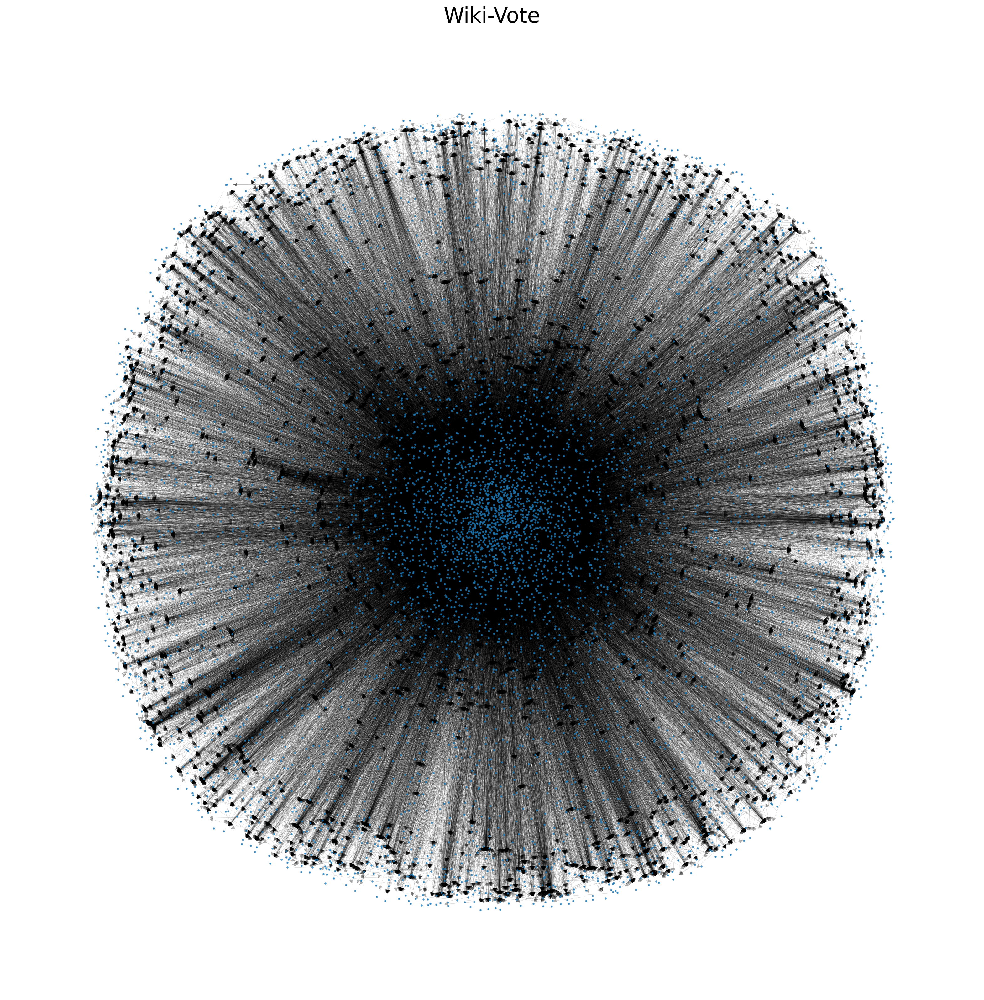

In [71]:
plt.figure(figsize=(20, 20), dpi=200)
pos = nx.spring_layout(G, k=0.15, iterations=50, seed=42)
nx.draw_networkx_nodes(G, pos, node_size=2, node_color='#1f78b4', alpha=0.7)
nx.draw_networkx_edges(G, pos, width=0.15, alpha=0.3, edge_color='black')
plt.title("Wiki-Vote", fontsize=24)
plt.axis("off")
plt.show()

In [74]:
nx.write_gexf(G, "wiki_vote_gephi.gexf")

In [78]:
communities = list(community.greedy_modularity_communities(G))
partition = {node: i for i, comm in enumerate(communities) for node in comm}
mod_value = community.modularity(G, communities)
print(f"Modularity: {mod_value:.4f} \nNumber of communities: {len(communities)}")

Modularity: 0.3319 
Number of communities: 57
